<img src="NotebookAddons/blackboard-banner.jpg" width="100%" />
<font face="Calibri">
<br>
<font size="7"> <b> GEOS 657: Microwave Remote Sensing<b> </font>

<font size="5"> <b>Lab 8: Change Detection in <font color='rgba(200,0,0,0.2)'>Your Own</font> SAR Amplitude Time Series Stack </b> </font>

<br>
<font size="4"> <b> Franz J Meyer; University of Alaska Fairbanks & Josef Kellndorfer, <a href="http://earthbigdata.com/" target="_blank">Earth Big Data, LLC</a> </b> <br>
<img style="padding: 7px" src="NotebookAddons/UAFLogo_A_647.png" width="170" align="right"/>
</font>

<font size="3"> This Lab is part of the UAF course <a href="https://radar.community.uaf.edu/" target="_blank">GEOS 657: Microwave Remote Sensing</a>. It is introducing you to the methods of change detection in deep multi-temporal SAR image data stacks. Specifically, the lab applies the method of <i>Cumulative Sums</i> to perform change detection in a 60 image deep Sentinel-1 data stack over Niamey, Niger. As previously, the work will be done within the framework of a Jupyter Notebook.

<font color='rgba(200,0,0,0.2)'> <b>Note:</b> This version of Lab 8 is modified to allow for change detection analysis on your own data stack created within ASF HyP3</font> 
<br><br>

<b>In this chapter we introduce the following data analysis concepts:</b>

- How to use your own HyP3-generated data stack in a change detection effort
- The concepts of time series slicing by month, year, and date.
- The concepts and workflow of Cumulative Sum-based change point detection.
- The identification of change dates for each identified change point.
</font>

<font size="4"> <font color='rgba(200,0,0,0.2)'> <b>THIS NOTEBOOK INCLUDES NO HOMEWORK ASSIGNMENTS.</b></font> 

<font size="3">Contact me at fjmeyer@alaska.edu should you run into any problems.
</font>

</font>

<hr>
<font face="Calibri" size="5" color="red"> <b>Important Note about JupyterHub</b> </font>
<br><br>
<font face="Calibri" size="3"> <b>Your JupyterHub server will automatically shutdown when left idle for more than 1 hour. Your notebooks will not be lost but you will have to restart their kernels and re-run them from the beginning. You will not be able to seamlessly continue running a partially run notebook.</b> </font>


<hr>
<font face="Calibri">

<font size="5"> <b> 0. Importing Relevant Python Packages </b> </font>

<font size="3">In this notebook we will use the following scientific libraries:
<ol type="1">
    <li> <b><a href="https://pandas.pydata.org/" target="_blank">Pandas</a></b> is a Python library that provides high-level data structures and a vast variety of tools for analysis. The great feature of this package is the ability to translate rather complex operations with data into one or two commands. Pandas contains many built-in methods for filtering and combining data, as well as the time-series functionality. </li>
    <li> <b><a href="https://www.gdal.org/" target="_blank">GDAL</a></b> is a software library for reading and writing raster and vector geospatial data formats. It includes a collection of programs tailored for geospatial data processing. Most modern GIS systems (such as ArcGIS or QGIS) use GDAL in the background.</li>
    <li> <b><a href="http://www.numpy.org/" target="_blank">NumPy</a></b> is one of the principal packages for scientific applications of Python. It is intended for processing large multidimensional arrays and matrices, and an extensive collection of high-level mathematical functions and implemented methods makes it possible to perform various operations with these objects. </li>
    <li> <b><a href="https://matplotlib.org/index.html" target="_blank">Matplotlib</a></b> is a low-level library for creating two-dimensional diagrams and graphs. With its help, you can build diverse charts, from histograms and scatterplots to non-Cartesian coordinates graphs. Moreover, many popular plotting libraries are designed to work in conjunction with matplotlib. </li>
    <li> The <b><a href="https://www.pydoc.io/pypi/asf-hyp3-1.1.1/index.html" target="_blank">asf-hyp3 API</a></b> provides useful functions and scripts for accessing and processing SAR data via the Alaska Satellite Facility's Hybrid Pluggable Processing Pipeline, or HyP3 (pronounced "hype"). </li>
<li><b><a href="https://www.scipy.org/about.html" target="_blank">SciPY</a></b> is a library that provides functions for numerical integration, interpolation, optimization, linear algebra and statistics. </li>

</font>

<font face="Calibri" size="3"> Our first step is to <b>import them:</b> </font>

In [1]:
# Scientific Libraries
import pandas as pd
import gdal
import numpy as np
import matplotlib.pylab as plt
import matplotlib.pyplot as plb
import matplotlib.patches as patches
from matplotlib import animation
from matplotlib import rc

# General Purpose Libraries
import time
import os
import glob
import json # for loads
from IPython.display import HTML


from asf_notebook import earthdata_login
from asf_notebook import new_directory
from asf_notebook import download_hyp3_products
from asf_notebook import path_exists
from asf_notebook import remove_nan_subsets

<font face="Calibri" size="3"><b>set up matplotlib plotting</b> inside the notebook:</font>

In [2]:
%matplotlib inline 

<hr>
<font face="Calibri">

<font size="5"> <b> 1. Load Your Own Data Stack Into the Notebook </b> </font> 

<font size="3"> This lab assumes that you've created your own data stack over your personal area of interest using the <a href="https://www.asf.alaska.edu/" target="_blank">Alaska Satellite Facility's</a> value-added product system <a href="http://hyp3.asf.alaska.edu/" target="_blank">HyP3</a>. HyP3 is an environment that is used by ASF to prototype value added products and provide them to users to collect feedback. 

This lab expects <a href="https://media.asf.alaska.edu/uploads/RTC/rtc_atbd_v1.2_final.pdf" target="_blank">Radiometric Terrain Corrected</a> (RTC) image products as input, so be sure to select an RTC process when creating the subscription for your input data within HyP. Prefer a unique orbit geometry **(choose ascending or descending, not both)** to keep geometric differences between images low. 

We will retrieve HyP3 data via the HyP3 API. As both HyP3 and the Notebook environment sit in the <a href="https://aws.amazon.com/" target="_blank">Amazon Web Services (AWS)</a> cloud, data transfer is quick and cost effective.</font> 
</font>

<hr>
<font face="Calibri" size="3"> To download data from ASF, you need to provide your <a href="https://www.asf.alaska.edu/get-data/get-started/free-earthdata-account/" target="_blank">NASA Earth Data</a> username to the system. Setup an EarthData account if you do not yet have one. <font color='rgba(200,0,0,0.2)'><b>Note that EarthData's ULA applies when accessing the Hyp3 API from this notebook. If you have not acknowleged the ULA in EarthData, you will need to navigate to EarthData's home page and complete that process.</b></font>
<br><br>
<b>Login to Earthdata:</b> </font>

In [3]:
api = earthdata_login()

Enter your NASA EarthData username:
aflewandowski
Enter your password:
········

 login successful!


<hr>
<font face="Calibri" size="3"> Before we download anything, <b>create a working directory for this analysis and change into it:</b> </font>

In [4]:
path = "/home/jovyan/notebooks/ASF/GEOS_657_Labs/lab_8_own_data"
new_directory(path)
os.chdir(path)
print(f"Current working directory: {os.getcwd()}")

/home/jovyan/notebooks/ASF/GEOS_657_Labs/lab_8_own_data already exists.
Current working directory: /home/jovyan/notebooks/ASF/GEOS_657_Labs/lab_8_own_data


<font face="Calibri" size="3"><b>Create a folder in which to download your RTC products.</b> </font>

In [5]:
new_directory("rtc_products")
products_path = f"{path}/rtc_products"

rtc_products already exists.


<font face="Calibri" size="3"><b>Download the products associated with an existing RTC subscription.</b> </font>

In [6]:
subscription_id = download_hyp3_products(api, products_path)

Enter a subscription ID number:

Subscription id: 1661 Sierra_Negra_RTC_GAMMA

Subscription id: 1660 Nile_Delta_RTC_GAMMA

Subscription id: 1666 Jamalpur-RGB-Decomposition

Subscription id: 1643 MedicineLake_RTC_S1TBX

Subscription id: 1641 MedicineLake_RTC_GAMMA

Subscription id: 1663 Sierra_Negra_InSAR_GAMMA

Subscription id: 1658 Ted_Stevens_Airport_2018_Earthquake_RTC_GAMMA

Subscription id: 1665 Jamalpur_RTC_GAMMA

Subscription id: 1662 Sierra_Negra_RTC_S1TBX
1665

28 product/s associated with Subscription ID: 1665

Product Number 1:
/home/jovyan/notebooks/ASF/GEOS_657_Labs/lab_8_own_data/rtc_products/S1A_IW_GRDH_1SDV_20170412T120427_20170412T120444_016111_01A9AE_156D-POEORB-30m-power-rtc-gamma already exists.

Product Number 2:
/home/jovyan/notebooks/ASF/GEOS_657_Labs/lab_8_own_data/rtc_products/S1A_IW_GRDH_1SDV_20171021T120436_20171021T120501_018911_01FF3B_8DA3-POEORB-30m-power-rtc-gamma already exists.

Product Number 3:
/home/jovyan/notebooks/ASF/GEOS_657_Labs/lab_8_own_data/r

<hr>
<font face="Calibri" size="3"> Run the following code cell to visualize the image acquisition dates in your subscription. </font>

<hr>
<font face="Calibri" size="3"><b>Determine the subscription's process type</b>, which we need in order to determine the file paths to the VV tiffs.</font>

In [7]:
subscription_info = api.get_subscription(subscription_id)
process_type = subscription_info['process_id']

<font face="Calibri" size="3"><b>Create a variable called <i>paths</i>, that holds the paths to the VVs</b>, which varies based on process type:</font>

In [8]:
rtc_path = "rtc_products"
if path_exists(products_path):
    if process_type == 2: #GAMMA
        paths = f"{rtc_path}/*/*_VV.tif"   
    elif process_type == 18: #S1TBX
        paths = f"{rtc_path}/*/*-VV.tif" 
    else:
        print("This recipe requires RTC imagery.\nMake sure your Hyp subscription uses either RTC-GAMMA or RTC-S1TBX processes.")   

# We need dates for
#!ls granules/*/*_VV.tif | sort -t_ -k5,5 | cut -c 27-34 > butte.dates
#!cat butte.dates

<font face="Calibri" size="3"><b>Create a list containing the product acquisition dates:</b></font>

In [9]:
if paths:
        dates = []
        pth = glob.glob(paths)
        pth.sort()
        for p in pth:
            date = (p.split("_")[5])[0:8]
            dates.append(date)
            print(date)

20170223
20170307
20170319
20170331
20170412
20170424
20170506
20170518
20170530
20170611
20170623
20170705
20170717
20170729
20170810
20170822
20170903
20170915
20170927
20171009
20171021
20171102
20171114
20171126
20171208
20171220


<hr>
<font face="Calibri" size="3"> You may notice duplicates in your acquisition dates. As HyP3 processes SAR data on a frame-by-frame basis, duplicates may occur if your area of interest is covered by two consecutive  image frames. In this case, two separate images are generated that need to be merged together before time series processing can commence.
<br><br>
<b>Write functions to collect and print the paths of the VV tiffs:</b></font>

In [10]:
def get_tiff_paths(paths):
    tiff_paths = !ls $paths | sort -t_ -k5,5
    return tiff_paths

def print_tiff_paths(tiff_paths):
    print("Tiff paths:")
    for p in tiff_paths:
        print(f"{p}\n")

<font face="Calibri" size="3"><b>Collect and print the paths of the VV tiffs:</b></font>

In [11]:
tiff_paths = get_tiff_paths(paths)
print_tiff_paths(tiff_paths)

Tiff paths:
rtc_products/S1A_IW_GRDH_1SDV_20170223T120417_20170223T120442_015411_0194AE_F18E-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170223T120417_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170307T120417_20170307T120442_015586_0199F9_8DCA-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170307T120417_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170319T120426_20170319T120451_015761_019F2B_3A67-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170319T120426_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170331T120426_20170331T120451_015936_01A461_2F7D-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170331T120426_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170412T120427_20170412T120444_016111_01A9AE_156D-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170412T120427_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170424T120428_20170424T120453_016286_01AF0F_DDC2-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170424T120428_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170506T120428_20170506T120453_016461_01B453_99

<font face="Calibri" size="3"> <b>Concatenate neighboring image frames</b> should your area be covered by more than one frame. </font>

In [12]:
for k in range(1, len(dates)):
    if dates[k] == dates[k-1]:
        print(k)
        temp = tiff_paths[k-1]
        _, product_name, tiff_name = temp.split('/')
        gdal_command = f"gdal_merge.py -o rtc_products/{product_name}/new-{tiff_name} {tiff_paths[k]} {tiff_paths[k-1]}"
        print(f"Calling the command: {gdal_command}")
        !{gdal_command}
        rm_command = f"rm {tiff_paths[k]}"
        print(f"Calling the command: {rm_command}")
        !{rm_command}
        rm_command = f"rm {tiff_paths[k-1]}"
        print(f"Calling the command: {rm_command}")
        !{rm_command}

<font face="Calibri" size="3"><b>Update the paths of the VV tiffs:</b></font>

In [13]:
tiff_paths = get_tiff_paths(paths)
print_tiff_paths(tiff_paths)

Tiff paths:
rtc_products/S1A_IW_GRDH_1SDV_20170223T120417_20170223T120442_015411_0194AE_F18E-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170223T120417_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170307T120417_20170307T120442_015586_0199F9_8DCA-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170307T120417_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170319T120426_20170319T120451_015761_019F2B_3A67-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170319T120426_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170331T120426_20170331T120451_015936_01A461_2F7D-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170331T120426_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170412T120427_20170412T120444_016111_01A9AE_156D-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170412T120427_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170424T120428_20170424T120453_016286_01AF0F_DDC2-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170424T120428_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170506T120428_20170506T120453_016461_01B453_99

<hr>
<font face="Calibri" size="3"> <b>Fix multiple UTM Zone-related issues</b> should they exist in your data set. If multiple UTM zones are found, the following code cells will identify the predominant UTM zone and reproject the rest into that zone. </font>
<br><br>
<font face="Calibri" size="3"><b>Use gdal.Info to determine the UTM definition types and zones in each product:</b></font>

In [14]:
utm_zones = []
utm_types = []
print('Checking UTM Zones in the data stack ...\n')
for k in range(0, len(tiff_paths)):
    info = (gdal.Info(tiff_paths[k], options = ['-json']))
    info = (json.loads(info))['coordinateSystem']['wkt']
    zone = info[(len(info)-8):(len(info)-3)]
    utm_zones.append(zone)
    typ = info[(len(info)-15):(len(info)-11)]
    utm_types.append(typ)
print(f"UTM Zones:\n {utm_zones}\n")
print(f"UTM Types:\n {utm_types}")

Checking UTM Zones in the data stack ...

UTM Zones:
 ['32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646', '32646']

UTM Types:
 ['EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG', 'EPSG']


<font face="Calibri" size="3"><b>Identify the most commonly used UTM Zone in the data:</b></font>

In [15]:
utm_unique, counts = np.unique(utm_zones, return_counts=True)
a = np.where(counts == np.max(counts))
predominate_utm = utm_unique[a][0]
print(f"Predominate UTM Zone: {predominate_utm}")

Predominate UTM Zone: 32646


<font face="Calibri" size="3"><b>Reproject VVs with errant UTMs to the predominate UTM:</b></font>

In [16]:
reproject_indicies = [i for i, j in enumerate(utm_zones) if j != predominate_utm] #makes list of indicies in utm_zones that need to be reprojected
print('--------------------------------------------')
print('Reprojecting %4.1f files' %(len(reproject_indicies)))
print('--------------------------------------------')
for k in reproject_indicies:
    temppath = tiff_paths[k].strip()
    _, product_name, tiff_name = temppath.split('/')
    cmd = f"gdalwarp -overwrite rtc_products/{product_name}/{tiff_name} rtc_products/{product_name}/r{tiff_name} -s_srs {utm_types[k]}:{utm_zones[k]} -t_srs EPSG:{predominate_utm}"
    #print(f"Calling the command: {cmd}")
    !{cmd}
    rm_command = f"rm {tiff_paths[k].strip()}"
    #print(f"Calling the command: {rm_command}")
    !{rm_command}

--------------------------------------------
Reprojecting  0.0 files
--------------------------------------------


<hr>
<font face="Calibri" size="3"> <b>Verify that all duplicate dates were resolved:</b> </font>

In [17]:
dates = []
pth = glob.glob(paths)
pth.sort()
for p in pth:
    date = (p.split("_")[5])[0:8]
    dates.append(date)
if len(dates) == len(set(dates)):
    print(f"Duplicate dates resolved.")
else:
    print(f"Duplicate dates still present!")

Duplicate dates resolved.


<hr>
<font face="Calibri">

<font size="5"> <b> 2. Create Subset and Stack Up Your Data </b> </font> 

<font size="3"> Now you are ready to work with your data. The next cells allow you to select an area of interest (AOI; via bounding-box corner coordinates) for your data analysis. Once selected, the AOI is being extracted and a data stack is formed.

<b>As a first step, we extract your AOI from the full frames:</b>
</font> 
</font>

In [18]:
# Using Google Maps, get the rough bounding box for the subset
# Enter your corner coordinates below
upper_left_x = 89.668263
upper_left_y = 25.169304
lower_right_x = 90.015444
lower_right_y = 24.910358
print(f"upper left x coord: {upper_left_x}\nupper left y coord: {upper_left_y}\nlower right x coord: {lower_right_x}\nlower right y coord: {lower_right_y}")

upper left x coord: 89.668263
upper left y coord: 25.169304
lower right x coord: 90.015444
lower right y coord: 24.910358


<font size="3"> <b>Update the list of all the absolute paths of the VV tiffs:</b> </font> 

In [19]:
tiff_paths = get_tiff_paths(paths)
print_tiff_paths(tiff_paths)

Tiff paths:
rtc_products/S1A_IW_GRDH_1SDV_20170223T120417_20170223T120442_015411_0194AE_F18E-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170223T120417_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170307T120417_20170307T120442_015586_0199F9_8DCA-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170307T120417_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170319T120426_20170319T120451_015761_019F2B_3A67-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170319T120426_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170331T120426_20170331T120451_015936_01A461_2F7D-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170331T120426_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170412T120427_20170412T120444_016111_01A9AE_156D-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170412T120427_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170424T120428_20170424T120453_016286_01AF0F_DDC2-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20170424T120428_G_gpn_VV.tif

rtc_products/S1A_IW_GRDH_1SDV_20170506T120428_20170506T120453_016461_01B453_99

<font size="3"><b>Subset the _VV.tiffs and move them from the individual product directories into their own directory, /tiffs:</b>
</font> 

In [20]:
!mkdir -p tiffs
if path_exists('tiffs'):
    product_number = 1
    for tiff_path in tiff_paths:
        _, granule_name, tiff_name = tiff_path.split('/')
        g1, g2, g3, date, g4, g5, g6 = tiff_name.split('_')
        print(f"\nProduct #{product_number}:")
        product_number += 1
        gdal_command = f"gdal_translate -projwin {upper_left_x} {upper_left_y} {lower_right_x} {lower_right_y} -projwin_srs 'WGS84' -co \"COMPRESS=DEFLATE\" -a_nodata 0 {tiff_path} tiffs/{date}_VV.tiff"
        #gdal_command = f"gdal_translate -epo -eco -projwin {upper_left_x} {upper_left_y} {lower_right_x} {lower_right_y} -projwin_srs 'WGS84' -co \"COMPRESS=DEFLATE\" -a_nodata -1 {tiff_path} tiffs/{date}_VV.tiff"
        
        print(f"Calling the command: {gdal_command}")
        !{gdal_command}


Product #1:
Calling the command: gdal_translate -projwin 89.668263 25.169304 90.015444 24.910358 -projwin_srs 'WGS84' -co "COMPRESS=DEFLATE" -a_nodata 0 rtc_products/S1A_IW_GRDH_1SDV_20170223T120417_20170223T120442_015411_0194AE_F18E-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170223T120417_G_gpn_VV.tif tiffs/20170223T120417_VV.tiff
Input file size is 29260, 14068
0...10...20...30...40...50...60...70...80...90...100 - done.

Product #2:
Calling the command: gdal_translate -projwin 89.668263 25.169304 90.015444 24.910358 -projwin_srs 'WGS84' -co "COMPRESS=DEFLATE" -a_nodata 0 rtc_products/S1A_IW_GRDH_1SDV_20170307T120417_20170307T120442_015586_0199F9_8DCA-POEORB-30m-power-rtc-gamma/rnew-S1A_IW_RT30_20170307T120417_G_gpn_VV.tif tiffs/20170307T120417_VV.tiff
Input file size is 29260, 14069
0...10...20...30...40...50...60...70...80...90...100 - done.

Product #3:
Calling the command: gdal_translate -projwin 89.668263 25.169304 90.015444 24.910358 -projwin_srs 'WGS84' -co "COMPRESS=DEFLA

Input file size is 9508, 7059
0...10...20...30...40...50...60...70...80...90...100 - done.

Product #21:
Calling the command: gdal_translate -projwin 89.668263 25.169304 90.015444 24.910358 -projwin_srs 'WGS84' -co "COMPRESS=DEFLATE" -a_nodata 0 rtc_products/S1A_IW_GRDH_1SDV_20171021T120436_20171021T120501_018911_01FF3B_8DA3-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20171021T120436_G_gpn_VV.tif tiffs/20171021T120436_VV.tiff
Input file size is 9508, 7057
0...10...20...30...40...50...60...70...80...90...100 - done.

Product #22:
Calling the command: gdal_translate -projwin 89.668263 25.169304 90.015444 24.910358 -projwin_srs 'WGS84' -co "COMPRESS=DEFLATE" -a_nodata 0 rtc_products/S1A_IW_GRDH_1SDV_20171102T120436_20171102T120501_019086_02048A_5D76-POEORB-30m-power-rtc-gamma/S1A_IW_RT30_20171102T120436_G_gpn_VV.tif tiffs/20171102T120436_VV.tiff
Input file size is 9508, 7056
0...10...20...30...40...50...60...70...80...90...100 - done.

Product #23:
Calling the command: gdal_translate -projwin 

<font size="3"><b>Grab the updated paths of the VVs:</b></font>

<hr>
<font face="Calibri" size="3"> Now we stack up your data by creating a virtual raster table with links to all subset data files: </font>

In [21]:
tp = f"{path}/tiffs"
tiff_paths = get_tiff_paths(tp)
print_tiff_paths(tiff_paths)

Tiff paths:
20170223T120417_VV.tiff

20170307T120417_VV.tiff

20170319T120426_VV.tiff

20170331T120426_VV.tiff

20170412T120427_VV.tiff

20170424T120428_VV.tiff

20170506T120428_VV.tiff

20170518T120429_VV.tiff

20170530T120429_VV.tiff

20170611T120430_VV.tiff

20170623T120431_VV.tiff

20170705T120431_VV.tiff

20170717T120432_VV.tiff

20170729T120433_VV.tiff

20170810T120434_VV.tiff

20170822T120434_VV.tiff

20170903T120435_VV.tiff

20170915T120435_VV.tiff

20170927T120435_VV.tiff

20171009T120436_VV.tiff

20171021T120436_VV.tiff

20171102T120436_VV.tiff

20171114T120435_VV.tiff

20171126T120435_VV.tiff

20171208T120435_VV.tiff

20171220T120434_VV.tiff



<font size="3">In case you accidentaly created a subscription containing products with no data in your selected subset,<b> check the *_VV.tif files for nans (represented as 0 in numpy the array) and remove them.</b> If you don't do this and there are images with no data, they will appear as fully or partially black slides in your time-series animation.</font>

In [22]:
t_path = f"{path}/tiffs/"
tiff_paths = get_tiff_paths(t_path)
remove_nan_subsets(t_path, tiff_paths)

GeoTiffs Examined: 26
GeoTiffs Removed:  3


<font size="3"><b>Update the list of dates after removing nans:</b></font>

In [23]:
dates = []
pth = glob.glob(f"{t_path}/*_VV.tiff")
pth.sort()
for p in pth:
    date = p[len(p)-23:len(p)-15]
    dates.append(date)
    print(date)

20170319
20170331
20170424
20170506
20170518
20170530
20170611
20170623
20170705
20170717
20170729
20170810
20170822
20170903
20170915
20170927
20171009
20171021
20171102
20171114
20171126
20171208
20171220


<hr>
<font face="Calibri" size="3"> Now we stack up the data by creating a virtual raster table with links to all subset data files: </font>
<br><br>
<font size="3"><b>Create the virtual raster table for the subset GeoTiffs:</b></font>

In [24]:
# Create the VRT for the downloaded subset geotiffs
# Grab all tiffs in the directory
!gdalbuildvrt -separate rtc_products.vrt tiffs/*.tiff

0...10...20...30...40...50...60...70...80...90...100 - done.


<hr>
<font face="Calibri">

<font size="5"> <b> 3. Now You Can Work With Your Data </b> </font> 

<font size="3"> Now you are ready to perform time series change detection on your data stack.
</font> 
</font>

<br>
<font face="Calibri" size="4"> <b> 3.1 Define Data Directory and Path to VRT </b> </font> 
<br><br>
<font face="Calibri" size="3"><b>Create a variable containing the VRT filename:</b></font>

In [25]:
image_file = "rtc_products.vrt"

<font face="Calibri" size="3"><b>Create an index of timedelta64 data with Pandas:</b></font>

In [26]:
# Get some indices for plotting
time_index = pd.DatetimeIndex(dates)

<font face="Calibri" size="3"><b>Print the bands and dates for all images in the virtual raster table (VRT):</b></font>

In [27]:
j=1
print(f"Bands and dates for {image_file}")
for i in time_index:
    print("{:4d} {}".format(j, i.date()),end=' ')
    j+=1
    if j%5==1: print()

Bands and dates for rtc_products.vrt
   1 2017-03-19    2 2017-03-31    3 2017-04-24    4 2017-05-06    5 2017-05-18 
   6 2017-05-30    7 2017-06-11    8 2017-06-23    9 2017-07-05   10 2017-07-17 
  11 2017-07-29   12 2017-08-10   13 2017-08-22   14 2017-09-03   15 2017-09-15 
  16 2017-09-27   17 2017-10-09   18 2017-10-21   19 2017-11-02   20 2017-11-14 
  21 2017-11-26   22 2017-12-08   23 2017-12-20 

<hr>
<br>
<font face="Calibri" size="4"> <b> 3.2 Open Your Data Stack and Visualize Some Layers </b> </font> 

<font face="Calibri" size="3"> We will <b>open your VRT</b> and visualize some layers using Matplotlib. </font>

In [28]:
img = gdal.Open(image_file)

<font face="Calibri" size="3"><b>Print the bands, pixels, and lines:</b></font>

In [29]:
print(f"Number of  bands: {img.RasterCount}")
print(f"Number of pixels: {img.RasterXSize}")
print(f"Number of  lines: {img.RasterYSize}")

Number of  bands: 23
Number of pixels: 1146
Number of  lines: 984


<font face="Calibri" size="3"><b>Read in raster data for the first two bands:</b></font>

In [30]:
raster_1 = img.GetRasterBand(1).ReadAsArray() # change the number passed to GetRasterBand() to 
where_are_NaNs = np.isnan(raster_1)           # read rasters from different bands
raster_1[where_are_NaNs] = 0

raster_2 = img.GetRasterBand(2).ReadAsArray() #must pass a valid band number to GetRasterBand()
where_are_NaNs = np.isnan(raster_2)
raster_2[where_are_NaNs] = 0

<font face="Calibri" size="3"><b>Plot images and histograms for bands 1 and 2:</b></font>

Text(0.5, 1.0, 'Histogram Band 2 2017-03-31')

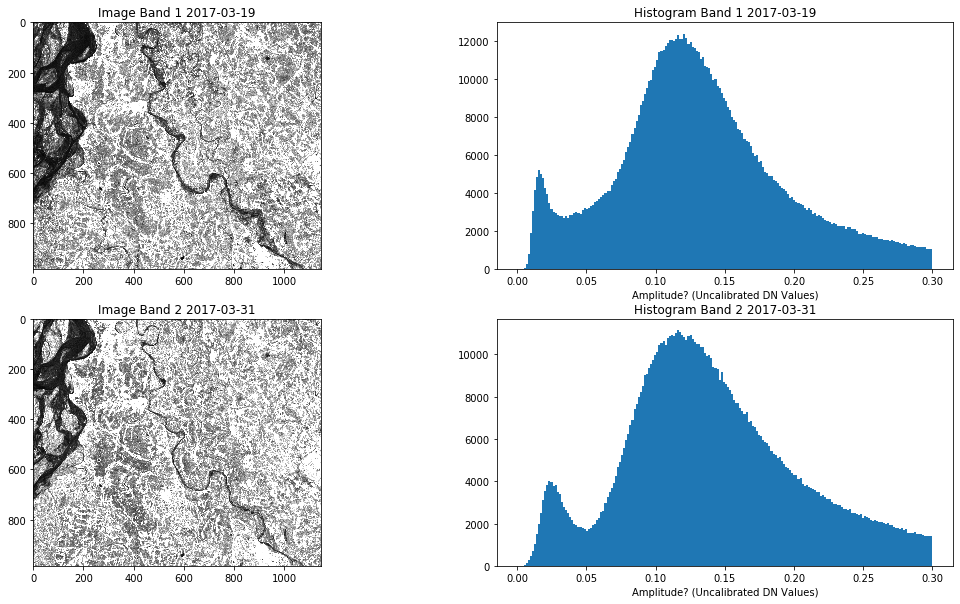

In [31]:
# Setup the pyplot plots
fig = plb.figure(figsize=(18,10)) # Initialize figure with a size
ax1 = fig.add_subplot(221)  # 221 determines: 2 rows, 2 plots, first plot
ax2 = fig.add_subplot(222)  # 222 determines: 2 rows, 2 plots, second plot
ax3 = fig.add_subplot(223)  # 223 determines: 2 rows, 2 plots, third plot
ax4 = fig.add_subplot(224)  # 224 determines: 2 rows, 2 plots, fourth plot

# Plot the band 1 image
band_number = 1
ax1.imshow(raster_1,cmap='gray', vmin=0, vmax=0.2) #,vmin=2000,vmax=10000)
ax1.set_title('Image Band {} {}'.format(band_number, time_index[band_number-1].date()))

# Flatten the band 1 image into a 1 dimensional vector and plot the histogram:
h = ax2.hist(raster_1.flatten(), bins=200, range=(0, 0.3))
ax2.xaxis.set_label_text('Amplitude? (Uncalibrated DN Values)')
ax2.set_title('Histogram Band {} {}'.format(band_number, time_index[band_number-1].date()))

# Plot the band 2 image
band_number = 2
ax3.imshow(raster_2,cmap='gray', vmin=0, vmax=0.2) #,vmin=2000,vmax=10000)
ax3.set_title('Image Band {} {}'.format(band_number, time_index[band_number-1].date()))

# Flatten the band 2 image into a 1 dimensional vector and plot the histogram:
h = ax4.hist(raster_2.flatten(),bins=200,range=(0,0.3))
ax4.xaxis.set_label_text('Amplitude? (Uncalibrated DN Values)')
ax4.set_title('Histogram Band {} {}'.format(band_number, time_index[band_number-1].date()))

<hr>
<br>
<font face="Calibri" size="4"> <b> 3.3 Create a Time Series Animation </b> </font>

<font face="Calibri" size="3"> Now we are ready to <b>create a time series animation</b> from the calibrated SAR data. </font> 

In [32]:
band = img.GetRasterBand(1)
raster0 = band.ReadAsArray()
band_number = 0 # Needed for updates
raster_stack = img.ReadAsArray()

In [33]:
raster_stack_masked = np.ma.masked_where(raster_stack==0, raster_stack)

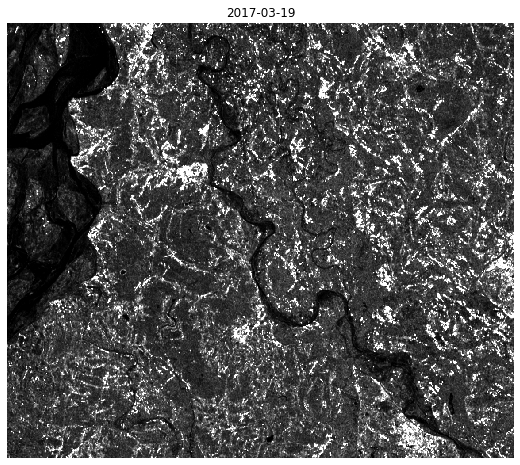

In [34]:
fig = plt.figure(figsize=(14, 8))
ax = fig.add_subplot(111)
ax.axis('off')
vmin = np.percentile(raster_stack.flatten(), 5)
vmax = np.percentile(raster_stack.flatten(), 95)

r0dB = 20 * np.log10(raster0) - 83

im = ax.imshow(raster0, cmap='gray', vmin=vmin, vmax=vmax)
ax.set_title("{}".format(time_index[0].date()))

def animate(i):
    ax.set_title("{}".format(time_index[i].date()))
    im.set_data(raster_stack[i])

# Interval is given in milliseconds
ani = animation.FuncAnimation(fig, animate, frames=raster_stack.shape[0], interval=400)

<font face="Calibri" size="3"><b>Configure matplotlib's RC settings for the animation:</b></font> 

In [35]:
rc('animation', embed_limit=40971520.0)  # We need to increase the limit maybe to show the entire animation

<font face="Calibri" size="3"><b>Create a javascript animation of the time-series running inline in the notebook:</b></font> 

In [36]:
HTML(ani.to_jshtml())

<font face="Calibri" size="3"><b>Delete the dummy png</b> that was saved to the current working directory while generating the javascript animation in the last code cell.</font> 

In [37]:
try:
    os.remove('None0000000.png')
except FileNotFoundError:
    pass

<font face="Calibri" size="3"><b>Save the animation as a gif:</b> </font> 

In [38]:
ani.save('animation.gif', writer='pillow', fps=2)

<br>
<hr>
<font face="Calibri" size="5"> <b> 4. Cumulative Sum-based Change Detection Across an Entire Image</b> </font> 

<font face="Calibri" size="3"> Using numpy arrays we can apply the concept of **cumulative sum change detection** analysis effectively on the entire image stack. We take advantage of array slicing and axis-based computing in numpy. **Axis 0 is the time domain** in our raster stacks.
    
<hr>
<font size="4"><b>4.1 Create our time series stack</b></font> 
<br><br>
<font size="3"><b>Calculate the dB scale:</b></font> 

In [39]:
db = 10.*np.log10(raster_stack_masked)

<font face="Calibri" size="3">Sometimes it makes sense to <b>extract a reduced time span</b> from the full time series to reduce the number of different change objects in a scene. In the following, we extract a shorter time span:
</font>

In [41]:
# Change these dates to fit your time span
start_date = '2017-06-01'
end_date = '2017-10-01'

date_index_subset = np.where((time_index>start_date) & (time_index<end_date))
db_subset = np.squeeze(db[date_index_subset, :, :])
time_index_subset = time_index[date_index_subset]

In [43]:
db_subset.shape

(10, 984, 1146)

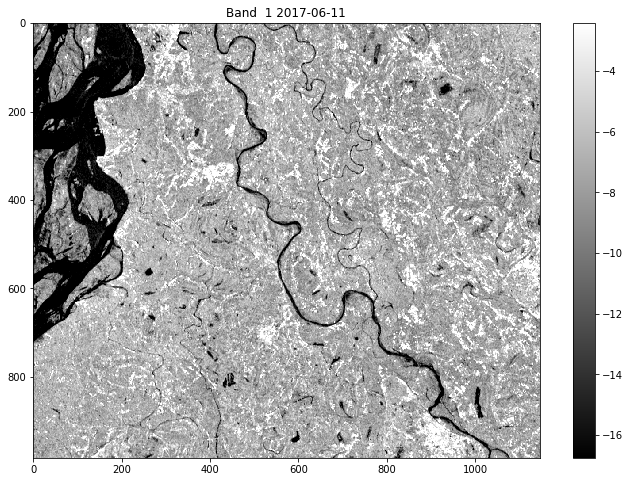

In [48]:
plt.figure(figsize=(12, 8))
band_number = 0
vmin = np.percentile(db_subset[band_number], 5)
vmax = np.percentile(db_subset[band_number], 95)
plt.title('Band  {} {}'.format(band_number+1, time_index_subset[band_number].date()))
plt.imshow(db_subset[0], cmap='gray', vmin=vmin, vmax=vmax)
_ = plt.colorbar()

<br>
<hr>
<font face="Calibri" size="4"> <b> 4.2 Calculate Mean Across Time Series to Prepare for Calculation of Cummulative Sum $S$:</b> </font> 

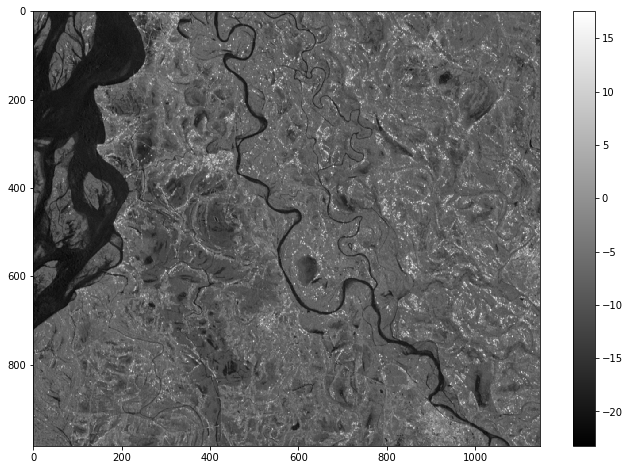

In [49]:
db_mean = np.mean(db_subset, axis=0)
plt.figure(figsize=(12, 8))
plt.imshow(db_mean, cmap='gray')
_ = plt.colorbar()

In [53]:
residuals = db_subset - db_mean

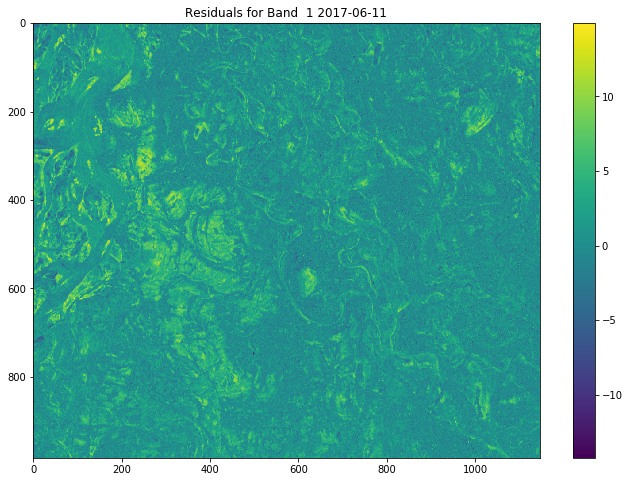

In [54]:
plt.figure(figsize=(12, 8))
plt.imshow(residuals[0])
plt.title('Residuals for Band  {} {}'.format(band_number+1, time_index_subset[band_number].date()))
_ = plt.colorbar()

<br>
<hr>
<font face="Calibri" size="4"> <b> 4.3 Calculate Cummulative Sum $S$ as well as Change Magnitude $S_{diff}$:</b> </font> 

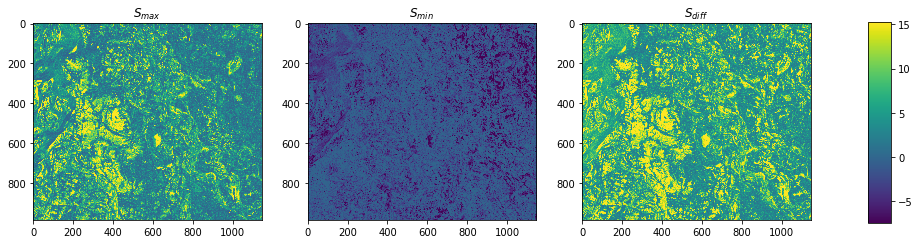

In [62]:
summation = np.cumsum(R,axis=0)
summation_max = np.max(summation, axis=0)
summation_min = np.min(summation, axis=0)
change_mag = summation_max - summation_min
fig, ax = plt.subplots(1, 3, figsize=(16, 4))
vmin = np.percentile(summation_min.flatten(), 3)
vmax = np.percentile(summation_max.flatten(), 97)
max_plot = ax[0].imshow(summation_max, vmin=vmin, vmax=vmax)
ax[0].imshow(summation_max, vmin=vmin, vmax=vmax)
ax[0].set_title('$S_{max}$')
ax[1].imshow(summation_min, vmin=vmin, vmax=vmax)
ax[1].set_title('$S_{min}$')
ax[2].imshow(change_mag, vmin=vmin, vmax=vmax)
ax[2].set_title('$S_{diff}$')
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
_ = fig.colorbar(max_plot, cax=cbar_ax)

<br>
<hr>
<font face="Calibri" size="4"> <b> 4.4 Mask $S_{diff}$ With a-priori Threshold To Idenfity Change Candidates:</b> </font>

<font face="Calibri" size="3">To identified change candidate pixels, we can threshold $S_{diff}$ to reduce computation of the bootstrapping. For land cover change, we would not expect more than 5-10% change pixels in a landscape. So, if the test region is reasonably large, setting a threshold for expected change to 10% is appropriate. In our example, we'll start out with a very conservative threshold of 50%.

The histogram for $S_{diff}$ is shown below.
</font>

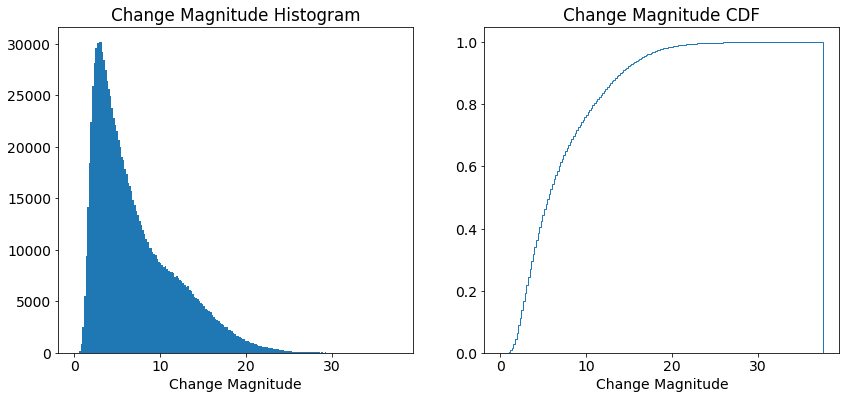

In [64]:
plt.rcParams.update({'font.size': 14})
fig = plt.figure(figsize=(14, 6)) # Initialize figure with a size
ax1 = fig.add_subplot(121)  # 121 determines: 2 rows, 2 plots, first plot
ax2 = fig.add_subplot(122)
# Second plot: Histogram
# IMPORTANT: To get a histogram, we first need to *flatten* 
# the two-dimensional image into a one-dimensional vector.
histogram = ax1.hist(change_mag.flatten(), bins=200, range=(0, np.max(change_mag)))
ax1.xaxis.set_label_text('Change Magnitude')
ax1.set_title('Change Magnitude Histogram')
plt.grid()
n, bins, patches = ax2.hist(change_mag.flatten(), bins=200, range=(0, np.max(change_mag)), cumulative='True', density='True', histtype='step', label='Empirical')
ax2.xaxis.set_label_text('Change Magnitude')
ax2.set_title('Change Magnitude CDF')
plt.grid()

In [74]:
precentile = 0.5
out_indicies = np.where(n>precentile)
threshold_index = np.min(out_indicies)
threshold = bins[threshold_index]
print('At the {}% percentile, the threshold value is {:2.2f}'.format(precentile*100, threshold))

At the 50.0% percentile, the threshold value is 5.64


<font face="Calibri" size="3">Using this threshold, we can <b>visualize our change candidate areas</b>:
</font>

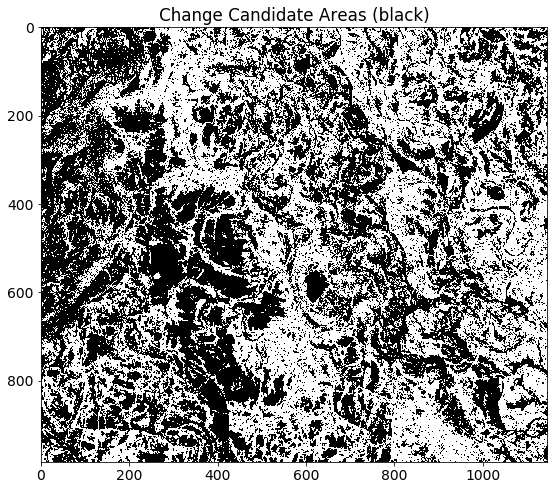

In [75]:
change_mag_mask = change_mag < threshold
plt.figure(figsize=(12, 8))
plt.title('Change Candidate Areas (black)')
_ = plt.imshow(change_mag_mask, cmap='gray')

<br>
<hr>
<font face="Calibri" size="4"> <b> 4.5 Bootstrapping to Prepare for Change Point Selection:</b> </font>

<font face="Calibri" size="3">We can now perform bootstrapping over the candidate pixels. The workflow is as follows:
<ul>
    <li>Filter our residuals to the change candidate pixels</li>
    <li>Perform bootstrapping over candidate pixels</li>
</ul>
For efficient computing we permutate the index of the time axis.
</font>

In [76]:
residuals_mask = np.broadcast_to(change_mag_mask , residuals.shape)
residuals_masked = np.ma.array(residuals, mask=residuals_mask)

<font face="Calibri" size="3">On the masked time series stack of residuals, we can re-compute the cumulative sums:
</font>

In [77]:
summation_masked = np.ma.cumsum(residuals_masked, axis=0)

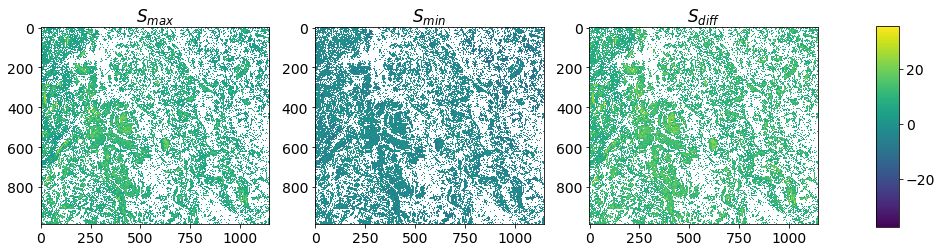

In [80]:
summation_masked_max = np.ma.max(summation_masked, axis=0)
summation_masked_min = np.ma.min(summation_masked, axis=0)
change_mag_masked = summation_masked_max - summation_masked_min
fig, ax = plt.subplots(1, 3, figsize=(16, 4))
vmin = summation_masked_min.min()
vmax = summation_masked_max.max()
masked_sum_max_plot = ax[0].imshow(summation_masked_max, vmin=vmin, vmax=vmax)
ax[0].set_title('$S_{max}$')
ax[1].imshow(summation_masked_min, vmin=vmin, vmax=vmax)
ax[1].set_title('$S_{min}$')
ax[2].imshow(change_mag_masked, vmin=vmin, vmax=vmax)
ax[2].set_title('$S_{diff}$')
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
_ = fig.colorbar(masked_sum_max_plot, cax=cbar_ax)

<font face="Calibri" size="3">Now let's perform <b>bootstrapping</b>:
</font>

In [81]:
random_index = np.random.permutation(residuals_masked.shape[0])
residuals_random = residuals_masked[random_index,:,:]

In [85]:
n_bootstraps = 100  # bootstrap sample size

# to keep track of the maxium Sdiff of the bootstrapped sample:
change_mag_random_max = np.ma.copy(change_mag_masked) 
change_mag_random_max[~change_mag_random_max.mask]=0
# to compute the Sdiff sums of the bootstrapped sample:
change_mag_random_sum = np.ma.copy(change_mag_masked) 
change_mag_random_sum[~change_mag_random_max.mask]=0
# to keep track of the count of the bootstrapped sample
n_change_mag_gt_change_mag_random = np.ma.copy(change_mag_masked) 
n_change_mag_gt_change_mag_random[~n_change_mag_gt_change_mag_random.mask]=0
print("Running Bootstrapping for %4.1f iterations ..." % (n_bootstraps))
for i in range(n_bootstraps):
    # For efficiency, we shuffle the time axis index and use that 
    #to randomize the masked array
    random_index = np.random.permutation(residuals_masked.shape[0])
    # Randomize the time step of the residuals
    residuals_random = residuals_masked[random_index,:,:]  
    summation_random = np.ma.cumsum(residuals_random, axis=0)
    summation_random_max = np.ma.max(summation_random, axis=0)
    summation_random_min = np.ma.min(summation_random, axis=0)
    change_mag_random = summation_random_max - summation_random_min
    change_mag_random_sum += change_mag_random
    change_mag_random_max[np.ma.greater(change_mag_random, change_mag_random_max)] = \
    change_mag_random[np.ma.greater(change_mag_random, change_mag_random_max)]
    n_change_mag_gt_change_mag_random[np.ma.greater(change_mag_masked, change_mag_random)] += 1
    if ((i+1)/n_bootstraps*100)%10 == 0:
        #print("%4.1f percent completed ..." % ((i+1)/n_bootstraps*100))
        print("\r%4.1f%% completed" % ((i+1)/n_bootstraps*100), end='\r', flush=True)
print(f"Bootstrapping Complete")

Running Bootstrapping for 100.0 iterations ...
Bootstrapping Complete


<br>
<hr>
<font face="Calibri" size="4"> <b> 4.6 Extract Confidence Metrics and Select Final Change Points:</b> </font>

<font face="Calibri" size="3">We first compute for all pixels the confidence level $CL$, the change point significance metric $CP_{significance}$ and the product of the two as our confidence metric for identified change points:
</font>

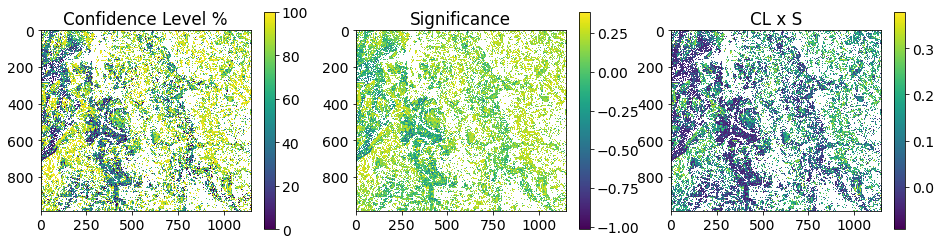

In [89]:
confidence_level = n_change_mag_gt_change_mag_random / n_bootstraps
change_point_significance = 1.- (change_mag_random_sum / n_bootstraps)/change_mag 
#Plot
fig, ax = plt.subplots(1, 3, figsize=(16, 4))
a = ax[0].imshow(confidence_level*100)
fig.colorbar(a, ax=ax[0])
ax[0].set_title('Confidence Level %')
a = ax[1].imshow(change_point_significance)
fig.colorbar(a, ax=ax[1])
ax[1].set_title('Significance')
a = ax[2].imshow(confidence_level*change_point_significance)
fig.colorbar(a, ax=ax[2])
_ = ax[2].set_title('CL x S')

<font face="Calibri" size="3">Now we can set a change point threshold to identify most likely change pixels in our map of change candidates:
</font>

In [90]:
change_point_threshold = 0.01

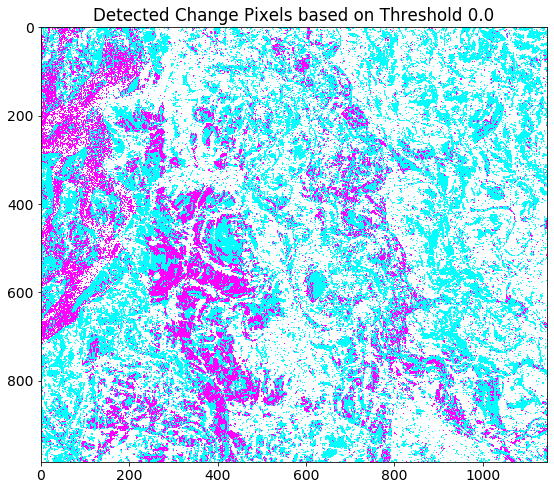

In [91]:
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(1, 1, 1)
plt.title('Detected Change Pixels based on Threshold %2.1f' % (change_point_threshold))
a = ax.imshow(confidence_level*change_point_significance < change_point_threshold, cmap='cool')

<br>
<hr>
<font face="Calibri" size="4"> <b> 4.7 Derive Timing of Change for Each Change Pixel:</b> </font>

<font face="Calibri" size="3">Our last step in the identification of the change points is to extract the timing of the change. We will produce a raster layer that shows the band number of this first date after a change was detected. We will make use of the numpy indexing scheme. First, we create a combined mask of the first threshold and the identified change points after the bootstrapping. For this we use the numpy "mask_or" operation.
</font>

In [92]:
# make a mask of our change points from the new threhold and the previous mask
change_point_mask = np.ma.mask_or(confidence_level*change_point_significance < change_point_threshold, confidence_level.mask)
# Broadcast the mask to the shape of the masked S curves
change_point_mask2 = np.broadcast_to(change_point_mask, summation_masked.shape)
# Make a numpy masked array with this mask
change_point_raster = np.ma.array(summation_masked.data, mask=change_point_mask2)

<font face="Calibri" size="3">To retrieve the dates of the change points we find the band indices in the time series along the time axis where the maximum of the cumulative sums was located. Numpy offers the "argmax" function for this purpose.
</font>

In [93]:
change_point_index = np.ma.argmax(change_point_raster, axis=0)
change_indices = list(np.unique(change_point_index))
change_indices.remove(0)
print(change_indices)
# Look up the dates from the indices to get the change dates
all_dates = time_index_subset
change_dates = [str(all_dates[x].date()) for x in change_indices]

[1, 2, 3, 4, 5, 6, 7, 8, 9]


<font face="Calibri" size="3">Lastly, we visualize the change dates by showing the $CP_{index}$ raster and label the change dates.
</font>

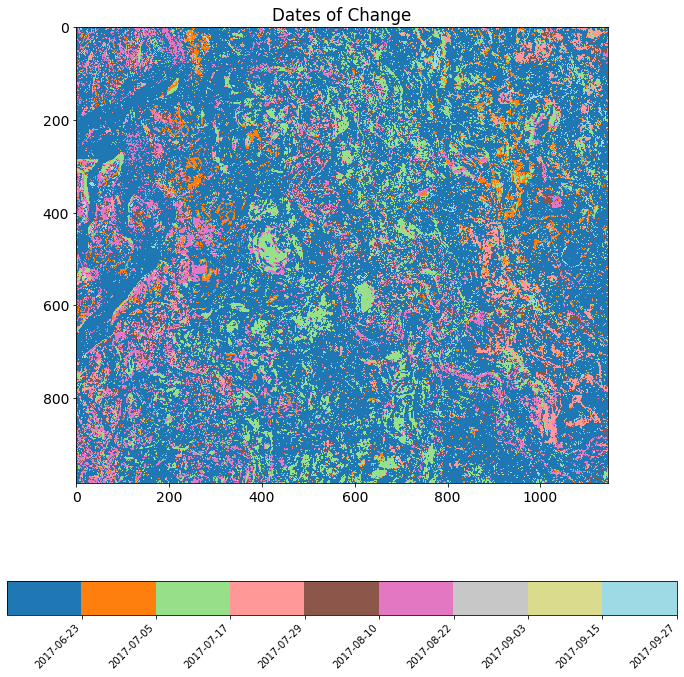

In [94]:
ticks = change_indices
ticklabels = change_dates

cmap = plt.cm.get_cmap('tab20', ticks[-1])
fig, ax = plt.subplots(figsize=(12, 12))
cax = ax.imshow(change_point_index, interpolation='nearest', cmap=cmap)
# fig.subplots_adjust(right=0.8)
# cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
# fig.colorbar(p,cax=cbar_ax)

ax.set_title('Dates of Change')
# cbar = fig.colorbar(cax,ticks=ticks)
cbar = fig.colorbar(cax, ticks=ticks, orientation='horizontal')
_ = cbar.ax.set_xticklabels(ticklabels, size=10, rotation=45, ha='right')  

<font face="Calibri" size="2"> <i>GEOS 657 Microwave Remote Sensing - Version 1.0 - April 2019 </i>
</font>